<a href="https://colab.research.google.com/github/djinnxs/TPIntegrador/blob/main/TPIntegrador.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Trabajo practico integrador Cohorte 2023
## Ariana Bardauil  - ariibardauil@gmail.com
## Julio Tapia - djinnxs@gmail.com
## Gustavo Ocampo - gustavo.ocampo@gmail.com

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Analisis Descriptivo de Datos


## *   Datos: Casos clínicos
##*   Ambito: Total país
##*   Fuente: [Ministerio de Salud de la República Argentina]





### Instalo los módulos necesarios

In [1]:
# %% Instalo los módulos necesarios
!pip install scipy
!pip install owslib # Manipulación de geoservicios
!pip install osmnx # Descarga de datos de OpenStreetMap
!pip install mapclassify
!pip install contextily
!pip install numpy
!pip install matplotlib
!pip install pandas
!pip install scipy
!pip install seaborn
!pip install folium
!pip install tabulate
!pip install geopandas
!pip pandas_profiling
!pip install ipywidgets
!pip install dash


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 221.1/221.1 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.4/101.4 kB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 kB 620.7 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 38.4 MB/s eta 0:00:00
ERROR: unknown command "pandas_profiling"
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 18.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 18.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.6/233.6 kB 19.7 MB/s eta 0:00:00
  Attempting uninstall: Werkzeug
    Found existing installation: Werkzeug 2.3.7
    Uninstalling Werkzeug-2.3.7:
      Successfully uninstalled Werkzeug-2.3.7


### Bibliotecas de Python

In [2]:
!pip install pandas-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.3/357.3 kB 31.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 10.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 47.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 28.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 76.2 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=b640950ed1d042c14f35859a8ac55252563e43fcc3d3d679034b37d3bba22cc1
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [3]:
from pandas_profiling import ProfileReport

<ipython-input-3-e2a33329b6f0>:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [4]:
# Importo los módulos necesarios
import os
os.environ['USE_PYGEOS'] = '0'
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point
import matplotlib.pyplot as plt
import mapclassify as mc
import contextily as ctx
import random
from owslib.wfs import WebFeatureService
from shapely.ops import nearest_points
from shapely.geometry import LineString
import numpy as np
from IPython.display import display
import seaborn as sbn
import folium
from tabulate import tabulate
from google.colab import drive
drive.mount('/content/drive')
import ipywidgets as widgets
from IPython.display import display, clear_output
import plotly.express as px
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output

Mounted at /content/drive


<ipython-input-4-21c0dc335ae4>:25: UserWarning: 
The dash_core_components package is deprecated. Please replace
`import dash_core_components as dcc` with `from dash import dcc`
  import dash_core_components as dcc
<ipython-input-4-21c0dc335ae4>:26: UserWarning: 
The dash_html_components package is deprecated. Please replace
`import dash_html_components as html` with `from dash import html`
  import dash_html_components as html


### Extracción y estructuras de datos 2018 - 2023

In [25]:
#La vamos a procesar con la función para leer csv en Pandas.
data1 = pd.read_csv('/content/drive/MyDrive/TPIntegrador/clinica_2018_2019.csv', sep=";", encoding="latin1")
#observamos las variables (-1) para vizulizar las últimas filas y ver la cantidad de registros
data1.head(-1)

<ipython-input-25-65e56e1aa52a>:2: DtypeWarning: Columns (22,24) have mixed types. Specify dtype option on import or set low_memory=False.
  data1 = pd.read_csv('/content/drive/MyDrive/TPIntegrador/clinica_2018_2019.csv', sep=";", encoding="latin1")


,ID_ENCABEZADO,ID_AGRP_CLINICA,ID_ORIGEN,ORIGEN,CODIGO_LOCALIDAD,LOCALIDAD,CODIGO_DEPTO,DEPARTAMENTO,CODIGO_PROVINCIA,PROVINCIA,...,ID_SNVS_EVENTO_AGRP,NOMBREEVENTOAGRP,IDEDAD,GRUPO,SEXO,RESIDENTE,AMBULATORIO,CANTIDAD,FECHAREGISTROCLINICA,USERREGISTROCLINICA
0,34913,365953,9699,HOSPITAL AREA PROGRAMA LAMARQUE DR. JORGE REBOK,62014070000,LAMARQUE,14,AVELLANEDA,62,Río Negro,...,3,Accidentes sin especificar,9,25 a 34,NaN,NaN,NaN,7,2018-08-13,leortiz
1,34913,365954,9699,HOSPITAL AREA PROGRAMA LAMARQUE DR. JORGE REBOK,62014070000,LAMARQUE,14,AVELLANEDA,62,Río Negro,...,3,Accidentes sin especificar,11,45 a 64,NaN,NaN,NaN,2,2018-08-13,leortiz
2,34913,365955,9699,HOSPITAL AREA PROGRAMA LAMARQUE DR. JORGE REBOK,62014070000,LAMARQUE,14,AVELLANEDA,62,Río Negro,...,3,Accidentes sin especificar,13,>= a 75,NaN,NaN,NaN,2,2018-08-13,leortiz
3,34913,365956,9699,HOSPITAL AREA PROGRAMA LAMARQUE DR. JORGE REBOK,62014070000,LAMARQUE,14,AVELLANEDA,62,Río Negro,...,2,Accidentes del hogar,13,>= a 75,NaN,NaN,NaN,1,2018-08-13,leortiz
4,34913,365957,9699,HOSPITAL AREA PROGRAMA LAMARQUE DR. JORGE REBOK,62014070000,LAMARQUE,14,AVELLANEDA,62,Río Negro,...,2,Accidentes del hogar,17,Edad Sin Esp.,NaN,NaN,NaN,1,2018-08-13,leortiz
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2870794,34878,365642,20496,HOSPITAL QUINES,74007050000,QUINES,7,AYACUCHO,74,San Luis,...,8,Enfermedad tipo influenza (ETI),7,15 a 19,NaN,NaN,NaN,2,2018-08-13,mnibanez
2870795,34878,365643,20496,HOSPITAL QUINES,74007050000,QUINES,7,AYACUCHO,74,San Luis,...,8,Enfermedad tipo influenza (ETI),8,20 a 24,NaN,NaN,NaN,2,2018-08-13,mnibanez
2870796,34878,365644,20496,HOSPITAL QUINES,74007050000,QUINES,7,AYACUCHO,74,San Luis,...,8,Enfermedad tipo influenza (ETI),9,25 a 34,NaN,NaN,NaN,2,2018-08-13,mnibanez
2870797,34878,365645,20496,HOSPITAL QUINES,74007050000,QUINES,7,AYACUCHO,74,San Luis,...,8,Enfermedad tipo influenza (ETI),10,35 a 44,NaN,NaN,NaN,4,2018-08-13,mnibanez


In [ ]:
data1.describe()

,ID_ENCABEZADO,ID_AGRP_CLINICA,ID_ORIGEN,CODIGO_LOCALIDAD,CODIGO_DEPTO,CODIGO_PROVINCIA,ANIO,SEMANA,IDESTADO,IDEVENTOAGRUPADO,ID_SNVS_EVENTO_AGRP,IDEDAD,CANTIDAD
count,2.870800e+06,2.870800e+06,2.870800e+06,2.870800e+06,2.870800e+06,2.870800e+06,2.870800e+06,2.870800e+06,2.870800e+06,2.870800e+06,2.870800e+06,2.870800e+06,2.870800e+06
mean,1.544666e+05,1.395184e+06,5.090499e+04,3.842866e+10,1.233985e+02,4.042941e+01,2.018590e+03,2.964502e+01,2.974618e+00,2.106678e+01,9.781153e+01,6.781636e+00,3.162084e+00
std,9.497968e+04,8.649254e+05,3.784573e+04,2.853412e+10,1.737471e+02,2.795232e+01,4.918357e-01,1.332709e+01,1.572839e-01,2.807336e+01,1.545993e+02,3.575521e+00,7.501134e+00
min,6.000000e+00,0.000000e+00,9.624000e+03,6.134090e+06,1.000000e+00,2.000000e+00,2.018000e+03,1.000000e+00,2.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,7.133100e+04,6.583728e+05,1.567400e+04,1.010518e+10,2.800000e+01,1.400000e+01,2.018000e+03,2.000000e+01,3.000000e+00,6.000000e+00,7.000000e+00,4.000000e+00,1.000000e+00
50%,1.546300e+05,1.382862e+06,3.401100e+04,3.401402e+10,6.300000e+01,3.800000e+01,2.019000e+03,3.000000e+01,3.000000e+00,6.000000e+00,1.000000e+01,7.000000e+00,1.000000e+00
75%,2.332370e+05,2.108823e+06,9.251900e+04,6.207001e+10,1.190000e+02,6.600000e+01,2.019000e+03,4.000000e+01,3.000000e+00,8.000000e+00,3.040000e+02,1.000000e+01,3.000000e+00
max,7.022590e+05,5.211179e+06,1.403880e+05,9.401402e+10,8.820000e+02,9.400000e+01,2.019000e+03,5.200000e+01,3.000000e+00,1.050000e+02,4.430000e+02,1.700000e+01,1.819000e+03


In [26]:
#La vamos a procesar con la función para leer csv en Pandas.
data2 = pd.read_csv('/content/drive/MyDrive/TPIntegrador/VM_SNVS_AGRUPADO_CLI1_MOVIL.csv', sep=";", encoding="latin1")
#El archivo CSV es de la misma estructura que el anterior, la diferencia es que contiene 2020 a 2023
#observamos las variables (-1) para vizulizar las últimas filas y ver la cantidad de registros
data2.head(-1)

<ipython-input-26-6121d888b86f>:2: DtypeWarning: Columns (22,24,27) have mixed types. Specify dtype option on import or set low_memory=False.
  data2 = pd.read_csv('/content/drive/MyDrive/TPIntegrador/VM_SNVS_AGRUPADO_CLI1_MOVIL.csv', sep=";", encoding="latin1")


,ID_ENCABEZADO,ID_AGRP_CLINICA,ID_ORIGEN,ORIGEN,CODIGO_LOCALIDAD,LOCALIDAD,CODIGO_DEPTO,DEPARTAMENTO,CODIGO_PROVINCIA,PROVINCIA,...,ID_SNVS_EVENTO_AGRP,NOMBREEVENTOAGRP,IDEDAD,GRUPO,SEXO,RESIDENTE,AMBULATORIO,CANTIDAD,FECHAREGISTROCLINICA,USERREGISTROCLINICA
0,809802,6137096,51075,FALDEO DEL VELAZCO SUR,46014010000,LA RIOJA,14,CAPITAL,46,La Rioja,...,8,Enfermedad tipo influenza (ETI),8,20 a 24,NaN,NaN,NaN,6,31/12/2022,mjbonoris
1,809786,6137021,96513,HOSPITAL PABLO SORIA,38021060000,SAN SALVADOR DE JUJUY,21,DR. MANUEL BELGRANO,38,Jujuy,...,2,Accidentes del hogar,11,45 a 64,NaN,NaN,NaN,10,31/12/2022,ssalvarado
2,809796,6137074,13745,HOSPITAL RURAL TELSEN,26105020000,TELSEN,105,TELSEN,26,Chubut,...,348,IRA Alta,7,15 a 19,NaN,NaN,NaN,1,31/12/2022,bnberoiza
3,809796,6137073,13745,HOSPITAL RURAL TELSEN,26105020000,TELSEN,105,TELSEN,26,Chubut,...,348,IRA Alta,6,10 a 14,NaN,NaN,NaN,1,31/12/2022,bnberoiza
4,809786,6137009,96513,HOSPITAL PABLO SORIA,38021060000,SAN SALVADOR DE JUJUY,21,DR. MANUEL BELGRANO,38,Jujuy,...,3,Accidentes sin especificar,10,35 a 44,NaN,NaN,NaN,15,31/12/2022,ssalvarado
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4470509,582344,0,71063,CAPS VALLECITO,70035070000,VALLECITO,35,CAUCETE,70,San Juan,...,0,,0,,,,,0,01/01/2000,NaN
4470510,623917,0,71063,CAPS VALLECITO,70035070000,VALLECITO,35,CAUCETE,70,San Juan,...,0,,0,,,,,0,01/01/2000,NaN
4470511,629239,0,91425,CENTRO DE SALUD VILLA MITRE,62063020000,RIO COLORADO,63,PICHI MAHUIDA,62,Río Negro,...,0,,0,,,,,0,01/01/2000,NaN
4470512,645709,0,91425,CENTRO DE SALUD VILLA MITRE,62063020000,RIO COLORADO,63,PICHI MAHUIDA,62,Río Negro,...,0,,0,,,,,0,01/01/2000,NaN


In [ ]:
data2.describe()

,ID_ENCABEZADO,ID_AGRP_CLINICA,ID_ORIGEN,CODIGO_LOCALIDAD,CODIGO_DEPTO,CODIGO_PROVINCIA,ANIO,SEMANA,IDESTADO,IDEVENTOAGRUPADO,ID_SNVS_EVENTO_AGRP,IDEDAD,CANTIDAD
count,4.470515e+06,4.470515e+06,4.470515e+06,4.470515e+06,4.470515e+06,4.470515e+06,4.470515e+06,4.470515e+06,4.470515e+06,4.470515e+06,4.470515e+06,4.470515e+06,4.470515e+06
mean,6.489968e+05,4.776613e+06,5.081470e+04,3.842171e+10,1.261197e+02,4.043351e+01,2.021522e+03,2.451022e+01,2.956562e+00,2.304821e+01,1.265388e+02,7.067296e+00,4.362516e+00
std,1.796206e+05,1.598830e+06,3.931591e+04,2.853905e+10,1.763132e+02,2.791682e+01,1.059009e+00,1.444710e+01,2.038399e-01,3.072898e+01,1.752513e+02,3.785111e+00,5.172935e+01
min,3.016210e+05,0.000000e+00,9.624000e+03,6.058020e+06,1.000000e+00,2.000000e+00,2.020000e+03,1.000000e+00,2.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,5.024660e+05,3.754184e+06,1.523200e+04,1.004903e+10,2.800000e+01,1.400000e+01,2.021000e+03,1.200000e+01,3.000000e+00,6.000000e+00,7.000000e+00,4.000000e+00,1.000000e+00
50%,6.670610e+05,4.901386e+06,2.591100e+04,3.401402e+10,6.300000e+01,3.800000e+01,2.022000e+03,2.400000e+01,3.000000e+00,6.000000e+00,1.100000e+01,7.000000e+00,1.000000e+00
75%,8.010770e+05,6.035360e+06,9.278800e+04,6.209106e+10,1.190000e+02,6.600000e+01,2.022000e+03,3.600000e+01,3.000000e+00,5.700000e+01,3.440000e+02,1.000000e+01,3.000000e+00
max,9.371640e+05,7.176491e+06,2.377930e+05,9.401402e+10,8.820000e+02,9.400000e+01,2.023000e+03,5.300000e+01,3.000000e+00,1.170000e+02,5.150000e+02,2.100000e+01,5.011200e+04


In [ ]:
#Visualizo las columnas del primer dataframe
data1.columns

Index(['ID_ENCABEZADO', 'ID_AGRP_CLINICA', 'ID_ORIGEN', 'ORIGEN',
       'CODIGO_LOCALIDAD', 'LOCALIDAD', 'CODIGO_DEPTO', 'DEPARTAMENTO',
       'CODIGO_PROVINCIA', 'PROVINCIA', 'ANIO', 'SEMANA', 'IDESTADO', 'ESTADO',
       'FECHAREGISTROENCABEZADO', 'USUARIOREGISTROENCABEZADO',
       'IDEVENTOAGRUPADO', 'NOMBREGRPEVENTOAGRP', 'ID_SNVS_EVENTO_AGRP',
       'NOMBREEVENTOAGRP', 'IDEDAD', 'GRUPO', 'SEXO', 'RESIDENTE',
       'AMBULATORIO', 'CANTIDAD', 'FECHAREGISTROCLINICA',
       'USERREGISTROCLINICA'],
      dtype='object')

In [ ]:
#Visualizo las columnas del segundo dataframe
data2.columns

Index(['ID_ENCABEZADO', 'ID_AGRP_CLINICA', 'ID_ORIGEN', 'ORIGEN',
       'CODIGO_LOCALIDAD', 'LOCALIDAD', 'CODIGO_DEPTO', 'DEPARTAMENTO',
       'CODIGO_PROVINCIA', 'PROVINCIA', 'ANIO', 'SEMANA', 'IDESTADO', 'ESTADO',
       'FECHAREGISTROENCABEZADO', 'USUARIOREGISTROENCABEZADO',
       'IDEVENTOAGRUPADO', 'NOMBREGRPEVENTOAGRP', 'ID_SNVS_EVENTO_AGRP',
       'NOMBREEVENTOAGRP', 'IDEDAD', 'GRUPO', 'SEXO', 'RESIDENTE',
       'AMBULATORIO', 'CANTIDAD', 'FECHAREGISTROCLINICA',
       'USERREGISTROCLINICA'],
      dtype='object')

Reestructurando fechas de dsitintos formatos

In [27]:
# Cambio 'FECHAREGISTROCLINICA' que es de tipo objet y está en formato 'aaaa-mm-dd'
data1['FECHAREGISTROCLINICA'] = pd.to_datetime(data1['FECHAREGISTROCLINICA'], format='%Y-%m-%d')


In [28]:
# Cambio 'FECHAREGISTROCLINICA' que es de tipo objet y está en formato 'dd/mm/aaaaa'
data2['FECHAREGISTROCLINICA'] = pd.to_datetime(data2['FECHAREGISTROCLINICA'], format='%d/%m/%Y')


Uniendo las bases clínicas

In [29]:
# Unimos verticalmente (uno encima del otro) ya que tienen la misma estructura y son años diferentes
clinica = pd.concat([data1, data2], axis=0)

Eliminando campos innecesarios para una mejor lectura y para alivianar los procesos

In [30]:
#A fin de obtener una mejor visivilización de los datos elimino campos que no usaremos
columnas_a_dejar = ['ID_ENCABEZADO', 'ID_AGRP_CLINICA', 'ID_ORIGEN', 'ORIGEN',
       'CODIGO_LOCALIDAD', 'LOCALIDAD', 'CODIGO_DEPTO', 'DEPARTAMENTO','IDESTADO', 'ESTADO','FECHAREGISTROENCABEZADO', 'USUARIOREGISTROENCABEZADO',
       'IDEVENTOAGRUPADO', 'NOMBREGRPEVENTOAGRP','RESIDENTE','AMBULATORIO','USERREGISTROCLINICA']
clinica.drop(columns=columnas_a_dejar, inplace=True)
clinica.head(5)

,CODIGO_PROVINCIA,PROVINCIA,ANIO,SEMANA,ID_SNVS_EVENTO_AGRP,NOMBREEVENTOAGRP,IDEDAD,GRUPO,SEXO,CANTIDAD,FECHAREGISTROCLINICA
0,62,Río Negro,2018,30,3,Accidentes sin especificar,9,25 a 34,NaN,7,2018-08-13
1,62,Río Negro,2018,30,3,Accidentes sin especificar,11,45 a 64,NaN,2,2018-08-13
2,62,Río Negro,2018,30,3,Accidentes sin especificar,13,>= a 75,NaN,2,2018-08-13
3,62,Río Negro,2018,30,2,Accidentes del hogar,13,>= a 75,NaN,1,2018-08-13
4,62,Río Negro,2018,30,2,Accidentes del hogar,17,Edad Sin Esp.,NaN,1,2018-08-13


Creando el DF a trabajar con un filtro específico

In [31]:
#Creo un dataframe diarreas y extraigo ese evento para alivianar la base
diarreas = clinica[clinica['NOMBREEVENTOAGRP'] == 'Diarreas']
diarreas.head(3)

,CODIGO_PROVINCIA,PROVINCIA,ANIO,SEMANA,ID_SNVS_EVENTO_AGRP,NOMBREEVENTOAGRP,IDEDAD,GRUPO,SEXO,CANTIDAD,FECHAREGISTROCLINICA
8,62,Río Negro,2018,30,11,Diarreas,3,12 a 23 m,NaN,1,2018-08-13
29,26,Chubut,2018,27,11,Diarreas,4,2 a 4,NaN,9,2018-07-10
30,26,Chubut,2018,27,11,Diarreas,5,5 a 9,NaN,4,2018-07-10


Reestructurando fechas de la unión anterior

In [32]:
#A fin de ser usado en un futuro para eventuales análisis reconvierto las fechas para serie de tiempo
diarreas['FECHAREGISTROCLINICA'] = diarreas['FECHAREGISTROCLINICA'].dt.strftime('%d/%m/%Y')
diarreas.head(-5)

<ipython-input-32-2dccdbe43934>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diarreas['FECHAREGISTROCLINICA'] = diarreas['FECHAREGISTROCLINICA'].dt.strftime('%d/%m/%Y')


,CODIGO_PROVINCIA,PROVINCIA,ANIO,SEMANA,ID_SNVS_EVENTO_AGRP,NOMBREEVENTOAGRP,IDEDAD,GRUPO,SEXO,CANTIDAD,FECHAREGISTROCLINICA
8,62,Río Negro,2018,30,11,Diarreas,3,12 a 23 m,NaN,1,13/08/2018
29,26,Chubut,2018,27,11,Diarreas,4,2 a 4,NaN,9,10/07/2018
30,26,Chubut,2018,27,11,Diarreas,5,5 a 9,NaN,4,10/07/2018
31,26,Chubut,2018,27,11,Diarreas,6,10 a 14,NaN,4,10/07/2018
32,26,Chubut,2018,27,11,Diarreas,8,20 a 24,NaN,2,10/07/2018
...,...,...,...,...,...,...,...,...,...,...,...
4276303,78,Santa Cruz,2022,43,11,Diarreas,5,5 a 9,NaN,2,01/01/2023
4276305,62,Río Negro,2022,51,11,Diarreas,11,45 a 64,NaN,1,01/01/2023
4276308,62,Río Negro,2022,51,11,Diarreas,13,>= a 75,NaN,1,01/01/2023
4276309,78,Santa Cruz,2022,43,11,Diarreas,6,10 a 14,NaN,6,01/01/2023


In [18]:
#observamos que la unión (suma) de ambos dataframes se realizó exitosamente
diarreas.head(-1)

,CODIGO_PROVINCIA,PROVINCIA,ANIO,SEMANA,ID_SNVS_EVENTO_AGRP,NOMBREEVENTOAGRP,IDEDAD,GRUPO,SEXO,CANTIDAD,FECHAREGISTROCLINICA
8,62,Río Negro,2018,30,11,Diarreas,3,12 a 23 m,NaN,1,13/08/2018
29,26,Chubut,2018,27,11,Diarreas,4,2 a 4,NaN,9,10/07/2018
30,26,Chubut,2018,27,11,Diarreas,5,5 a 9,NaN,4,10/07/2018
31,26,Chubut,2018,27,11,Diarreas,6,10 a 14,NaN,4,10/07/2018
32,26,Chubut,2018,27,11,Diarreas,8,20 a 24,NaN,2,10/07/2018
...,...,...,...,...,...,...,...,...,...,...,...
4276310,78,Santa Cruz,2022,26,11,Diarreas,4,2 a 4,NaN,1,01/01/2023
4276311,78,Santa Cruz,2022,26,11,Diarreas,3,12 a 23 m,NaN,2,01/01/2023
4276320,58,Neuquén,2021,52,11,Diarreas,5,5 a 9,NaN,1,01/01/2022
4276323,58,Neuquén,2021,49,11,Diarreas,11,45 a 64,NaN,1,01/01/2022


In [19]:
diarreas.shape

(1380027, 11)

In [33]:
diarreas.dtypes

CODIGO_PROVINCIA         int64
PROVINCIA               object
ANIO                     int64
SEMANA                   int64
ID_SNVS_EVENTO_AGRP      int64
NOMBREEVENTOAGRP        object
IDEDAD                   int64
GRUPO                   object
SEXO                    object
CANTIDAD                 int64
FECHAREGISTROCLINICA    object
dtype: object

Cargo la base de población del Indec

In [ ]:
#Agregamos una proyección de población por Departamento de Indec con la función para leer csv en Pandas.
pobdep = pd.read_csv('/content/drive/MyDrive/TPIntegrador/proyecciones_depto_indec.csv', sep=",", encoding="utf8")
#observamos las variables, poblacion por departamento
pobdep.head()

,juri_nombre,departamento_nombre,sexo_nombre,juri_codigo,departamento_codigo,sexo_codigo,ano,poblacion
0,Buenos Aires,Almirante Brown,Ambos sexos,6,28,0,2010,557025.0
1,Buenos Aires,Almirante Brown,Ambos sexos,6,28,0,2011,561349.0
2,Buenos Aires,Almirante Brown,Ambos sexos,6,28,0,2012,565509.0
3,Buenos Aires,Almirante Brown,Ambos sexos,6,28,0,2013,569911.0
4,Buenos Aires,Almirante Brown,Ambos sexos,6,28,0,2014,574263.0


In [ ]:
#Visualizo el el tipo de campos que tiene
pobdep.dtypes

juri_nombre             object
departamento_nombre     object
sexo_nombre             object
juri_codigo              int64
departamento_codigo      int64
sexo_codigo              int64
ano                      int64
poblacion              float64
dtype: object

In [ ]:
#Agregamos una proyección de población por Provincia de Indec con la función para leer csv en Pandas.
pobprov = pd.read_csv('/content/drive/MyDrive/TPIntegrador/poblacionxprovinciaindec.csv', sep=",", encoding="utf8")
#observamos las variables, poblacion por provincia
pobprov.head()

,ano,juri,juri_nombre,sexo_codigo,sexo_nombre,edad,poblacion
0,2010,1,TOTAL DEL PAÍS,0,Ambos sexos,0-4,3571540
1,2010,1,TOTAL DEL PAÍS,1,Varones,0-4,1838771
2,2010,1,TOTAL DEL PAÍS,2,Mujeres,0-4,1732769
3,2010,1,TOTAL DEL PAÍS,0,Ambos sexos,5-9,3507135
4,2010,1,TOTAL DEL PAÍS,1,Varones,5-9,1794531


In [ ]:
#Visualizo el el tipo de campos que tiene
pobprov.dtypes

ano             int64
juri            int64
juri_nombre    object
sexo_codigo     int64
sexo_nombre    object
edad           object
poblacion       int64
dtype: object

# Cargo la capa de mapas desde un servicio WFS de IGN

In [35]:

# URL del servicio WFS
wfs_url = "https://wms.ign.gob.ar/geoserver/ows?service=wms&version=1.3.0&request=GetCapabilities" # IDE País desde Instituto Geográfico Nacional

# Solicitud GetCapabilities al servicio WFS
wfs = WebFeatureService(wfs_url, version='1.0.0')

In [36]:
# Obtener la lista de capas (layers) disponibles
layers = list(wfs.contents)

# Imprimir la lista de capas
for layer_name in layers:
    print("Capa:", layer_name)

Capa: ign:doscientas_millas_sector_antartico
Capa: ign:puntos_de_geomorfologia_DB120
Capa: ign:lineas_de_zona_costera_BA040
Capa: ign:lineas_de_aguas_continentales_BH030
Capa: ign:lineas_de_aguas_continentales_BH010
Capa: ign:puntos_de_transporte_aereo_GB005
Capa: ign:puntos_de_transporte_aereo_GB001
Capa: ign:edafologia_afloramiento_rocoso
Capa: ign:puntos_de_cruces_y_enlaces_AQ065
Capa: ign:puntos_de_comunicacion_AT010
Capa: ign:edafologia_arenal
Capa: ign:ayuda_a_la_navegacion_BC101
Capa: ign:lineas_de_geomorfologia_barranca
Capa: ign:areas_de_glaciologia_050705
Capa: ign:edafologia_barrial_barrizal
Capa: ign:bahra_base_antartica
Capa: ign:vegetacion_arborea_060301
Capa: ign:vegetacion_arborea_EC015
Capa: ign:ayuda_a_la_navegacion_BC020
Capa: ign:areas_de_aguas_continentales_BH020
Capa: ign:lineas_de_aguas_continentales_BH020
Capa: ign:areas_de_extraccion_AA012
Capa: ign:cartas_100000
Capa: ign:cartas_250000
Capa: ign:cartas_50000
Capa: ign:cartas_500000
Capa: ign:puntos_de_aguas_co

In [37]:
# ign:provincia
provincia = gpd.read_file(wfs.getfeature(typename=['provincia']))

# Verificación de coordenadas
print(provincia.crs)

# ign:provincia
provincia = gpd.read_file(wfs.getfeature(typename=['provincia']))
provincia = provincia.set_crs('EPSG:4326')

None


In [ ]:
provincia.head(25)

,gml_id,gid,entidad,fna,gna,nam,in1,fdc,sag,geometry
0,provincia.1,1,0.0,Ciudad Autónoma de Buenos Aires,Ciudad Autónoma,Ciudad Autónoma de Buenos Aires,02,Geografía,IGN,"MULTIPOLYGON (((-58.45535 -34.52776, -58.45404..."
1,provincia.2,2,0.0,Provincia del Neuquén,Provincia,Neuquén,58,Geografía,IGN,"MULTIPOLYGON (((-70.39341 -36.15624, -70.39333..."
2,provincia.3,3,0.0,Provincia de San Luis,Provincia,San Luis,74,Geografía,IGN,"MULTIPOLYGON (((-67.05547 -31.85605, -67.05000..."
3,provincia.4,4,0.0,Provincia de Santa Fe,Provincia,Santa Fe,82,Geografía,IGN,"MULTIPOLYGON (((-61.04639 -27.99800, -61.00805..."
4,provincia.5,5,0.0,Provincia de La Rioja,Provincia,La Rioja,46,Geografía,IGN,"MULTIPOLYGON (((-68.52136 -27.81792, -68.52148..."
5,provincia.6,6,0.0,Provincia de Catamarca,Provincia,Catamarca,10,Geografía,IGN,"MULTIPOLYGON (((-68.50537 -25.16851, -68.50386..."
6,provincia.7,7,0.0,Provincia de Tucumán,Provincia,Tucumán,90,Geografía,IGN,"MULTIPOLYGON (((-65.35915 -26.05944, -65.35868..."
7,provincia.8,8,0.0,Provincia del Chaco,Provincia,Chaco,22,Geografía,IGN,"MULTIPOLYGON (((-62.32434 -24.12318, -62.31959..."
8,provincia.9,9,0.0,Provincia de Formosa,Provincia,Formosa,34,Geografía,IGN,"MULTIPOLYGON (((-62.31201 -22.48666, -62.31056..."
9,provincia.10,10,0.0,Provincia de Santa Cruz,Provincia,Santa Cruz,78,Geografía,IGN,"MULTIPOLYGON (((-67.59361 -46.01744, -67.59357..."


In [ ]:
provincia.dtypes

gml_id        object
gid            int64
entidad      float64
fna           object
gna           object
nam           object
in1           object
fdc           object
sag           object
geometry    geometry
dtype: object

Visualizo el mapa para ver si está todo bien

In [ ]:
mapa = provincia.explore(
    style_kwds=dict(stroke=True, # Habilitar borde
                    weight=1, # Grosor en px del borde
                    color = 'red', # Color de borde
                    fillColor='red', # Color de relleno
                    fillOpacity=0.5),  # Opacidad de relleno
    name="provincia",  # Nombre del layer en el control de capas
)

mapa # Mostrar mapa

In [ ]:
# Agrupo por 'PROVINCIA' y 'ANIO' y sumo la columna 'CANTIDAD'
diarreas_agrupadas = diarreas.groupby(['PROVINCIA', 'ANIO'], as_index=False).agg({
    'LOCALIDAD': 'first',
    'CODIGO_DEPTO': 'first',
    'DEPARTAMENTO': 'first',
    'CODIGO_PROVINCIA': 'first',
    'SEMANA': 'first',
    'IDESTADO': 'first',
    'ESTADO': 'first',
    'FECHAREGISTROENCABEZADO': 'first',
    'USUARIOREGISTROENCABEZADO': 'first',
    'IDEVENTOAGRUPADO': 'first',
    'NOMBREGRPEVENTOAGRP': 'first',
    'ID_SNVS_EVENTO_AGRP': 'first',
    'NOMBREEVENTOAGRP': 'first',
    'IDEDAD': 'first',
    'GRUPO': 'first',
    'SEXO': 'first',
    'CANTIDAD': 'sum'

})
#Ordeno por provincia y por año
diarreas_agrupadas = diarreas_agrupadas.sort_values(by=['PROVINCIA', 'ANIO']).reset_index(drop=True)
#muestro las primeras 5 filas ya que son 5 años para ver el resultado
diarreas_agrupadas.head(5)

,PROVINCIA,ANIO,LOCALIDAD,CODIGO_DEPTO,DEPARTAMENTO,CODIGO_PROVINCIA,SEMANA,IDESTADO,ESTADO,FECHAREGISTROENCABEZADO,USUARIOREGISTROENCABEZADO,IDEVENTOAGRUPADO,NOMBREGRPEVENTOAGRP,ID_SNVS_EVENTO_AGRP,NOMBREEVENTOAGRP,IDEDAD,GRUPO,SEXO,CANTIDAD
0,Buenos Aires,2018,CARLOS SPEGAZZINI,270,EZEIZA,6,40,3,CARGADA DATOS DISTINTO DE CERO,2018-10-18,msmarfeo,7,Gastroentéricas,11,Diarreas,7,15 a 19,None,86597
1,Buenos Aires,2019,LA PLATA,441,LA PLATA,6,47,3,CARGADA DATOS DISTINTO DE CERO,2019-11-29,rmmerlino,7,Gastroentéricas,11,Diarreas,6,10 a 14,None,153403
2,Buenos Aires,2020,RAMALLO,665,RAMALLO,6,45,3,CARGADA DATOS DISTINTO DE CERO,04/12/2020,rmgimenez,7,Gastroentéricas,11,Diarreas,5,5 a 9,None,74859
3,Buenos Aires,2021,LANUS OESTE,434,LANÚS,6,42,3,CARGADA DATOS DISTINTO DE CERO,31/10/2021,mnlujan,7,Gastroentéricas,11,Diarreas,9,25 a 34,None,78770
4,Buenos Aires,2022,LANUS OESTE,434,LANÚS,6,50,3,CARGADA DATOS DISTINTO DE CERO,31/12/2022,mnlujan,7,Gastroentéricas,11,Diarreas,1,< 6 m,None,119776


In [ ]:
diarreas_agrupadas.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#Muestro cantidad de diarreas por provicnia por grupo de edad por año deslizando el selector de año
# Crear una aplicación Dash
app = dash.Dash(__name__)

# Definir el estilo para el label
label_style = {'color': 'lightgreen', 'font-weight': 'bold'}

# Defino el diseño
app.layout = html.Div([
    html.Label("Selecciona un año:", style=label_style),  #pongo el título para que el lector vea el slide selector
    dcc.Slider(
        id='anio-slider',
        min=diarreas['ANIO'].min(),
        max=diarreas['ANIO'].max(),
        value=diarreas['ANIO'].min(),
        marks={str(anio): str(anio) for anio in diarreas['ANIO'].unique()},
        step=None
    ),
    dcc.Graph(id='grafico')
])

# Callback para actualizar el gráfico basado en el año seleccionado
@app.callback(
    Output('grafico', 'figure'),
    [Input('anio-slider', 'value')]
)
def update_graph(selected_anio):
    filtered_df = diarreas[diarreas['ANIO'] == selected_anio]  # Filtrar por el año seleccionado
    grouped_df = filtered_df.groupby(['PROVINCIA', 'GRUPO']).agg({'CANTIDAD': 'sum'}).reset_index()

    fig = px.bar(grouped_df, x='PROVINCIA', y='CANTIDAD', color='GRUPO', title=f'Distribución cantidad de diarreas por grupo de edad en {selected_anio}')

    return fig

if __name__ == '__main__':
    app.run_server(debug=True)


<IPython.core.display.Javascript object>

In [ ]:
# Aplicar formato de dos dígitos a los códigos de provincia en 'diarreas_agrupadas'
# BA y CABA viene con id 2 y 6 y deben quedar 02 y 06 para el join
#ya que mostraban ese distrito vacio al quedar fuera del join
diarreas_agrupadas['CODIGO_PROVINCIA'] = diarreas_agrupadas['CODIGO_PROVINCIA'].apply(lambda x: f"{x:02d}")

# Función para actualizar el mapa según el año seleccionado
def update_map(selected_year):
    # Filtrar los datos de 'diarreas_agrupadas' por el año seleccionado
    filtered_data = diarreas_agrupadas[diarreas_agrupadas['ANIO'] == selected_year]

    # Realizar la unión entre 'provincia' y 'filtered_data' basada en los campos 'in1' y 'CODIGO_PROVINCIA'
    result = provincia.merge(filtered_data, left_on='in1', right_on='CODIGO_PROVINCIA', how='inner')

    # Crear una figura y ejes para el mapa
    fig, ax = plt.subplots(figsize=(12, 8))

    # Visualizar el GeoDataFrame 'result'
    provincia.boundary.plot(ax=ax, linewidth=1.0, color='gray')  # Límites de las provincias
    result.plot(column='CANTIDAD', cmap='YlOrRd', legend=True, ax=ax)

    # Agregar una leyenda
    ax.set_title(f'Diarreas por Provincia - Año {selected_year}')

    # Mostrar el mapa
    plt.show()

# Crear un selector interactivo de año con el título personalizado
year_selector = widgets.IntSlider(min=diarreas_agrupadas['ANIO'].min(),
                                   max=diarreas_agrupadas['ANIO'].max(),
                                   step=1,
                                   description='Mueva el selector para ver el año:',  # Título personalizado
                                   continuous_update=False)

# Vincular el selector de año con la función de actualización del mapa
widgets.interactive(update_map, selected_year=year_selector)



interactive(children=(IntSlider(value=2018, continuous_update=False, description='Mueva el selector para ver e…

In [ ]:
# Convertir el campo 'CODIGO_PROVINCIA' en 'diarreas_agrupadas' a tipo objeto
diarreas_agrupadas['CODIGO_PROVINCIA'] = diarreas_agrupadas['CODIGO_PROVINCIA'].astype(str)

# Función para actualizar el mapa y mostrar la tabla según el año seleccionado
def update_map(selected_year):
    # Filtrar los datos de 'diarreas_agrupadas' por el año seleccionado
    filtered_data = diarreas_agrupadas[diarreas_agrupadas['ANIO'] == selected_year]

    # Realizar la unión entre 'provincia' y 'filtered_data' basada en los campos 'in1' y 'CODIGO_PROVINCIA'
    result = provincia.merge(filtered_data, left_on='in1', right_on='CODIGO_PROVINCIA', how='inner')

    # Crear una figura y ejes para el mapa
    fig, ax = plt.subplots(figsize=(12, 8))

    # Visualizar el GeoDataFrame 'result'
    provincia.boundary.plot(ax=ax, linewidth=1.0, color='gray')  # Límites de las provincias
    result.plot(column='CANTIDAD', cmap='YlOrRd', legend=True, ax=ax)

    # Agregar una leyenda
    ax.set_title(f'Diarreas por Provincia - Año {selected_year}')

    # Mostrar el mapa
    plt.show()

    # Mostrar la tabla resultante
    clear_output(wait=True)
    display(result)

# Crear un selector interactivo de año
year_selector = widgets.IntSlider(min=diarreas_agrupadas['ANIO'].min(),
                                   max=diarreas_agrupadas['ANIO'].max(),
                                   step=1,
                                   description='Año:',
                                   continuous_update=False)

# Vincular el selector de año con la función de actualización del mapa
widgets.interactive(update_map, selected_year=year_selector)

interactive(children=(IntSlider(value=2018, continuous_update=False, description='Año:', max=2023, min=2018), …

# Analisis Exploratorio de Datos (Ariana)


* Distribución de las variables
* Exploración de la poblacion de pacientes
* Cantidad de pacientes por zona
* Piramide poblacional de los pacientes



# Análisis de las Diarreas en Argentina (Ariana)


En este apartado:
tasas de diarreas
mapa de tasas de diarrea
Algo con regex

In [ ]:
# Filtramos el DataFrame para quedarnos solo con los eventos de diarrea (Adrián casos para mapa de casos)
df_diarrea = clinica[clinica['NOMBREEVENTOAGRP'] == 'Diarreas']

# Agrupamos por provincia y año, y sumamos la cantidad
df_diarrea_grouped = df_diarrea.groupby(['PROVINCIA', 'ANIO'])['CANTIDAD'].sum().reset_index()

# Mostramos el resultado
print(df_diarrea_grouped)


        PROVINCIA  ANIO  CANTIDAD
0    Buenos Aires  2018     86597
1    Buenos Aires  2019    153403
2    Buenos Aires  2020     74859
3    Buenos Aires  2021     78770
4    Buenos Aires  2022    119776
..            ...   ...       ...
139       Tucumán  2019     78366
140       Tucumán  2020     47653
141       Tucumán  2021     44575
142       Tucumán  2022     70081
143       Tucumán  2023     33238

[144 rows x 3 columns]


In [ ]:
# Filtro el DataFrame para obtener solo los casos de diarrea
casos_diarrea = clinica[clinica['NOMBREEVENTOAGRP'] == 'Diarreas']

# Utilizo pivot_table para crear la tabla
tabla_diarreas = pd.pivot_table(casos_diarrea, values='CANTIDAD', index=None, columns='ANIO', aggfunc='sum')

# Mostrar la tabla
print(tabla_diarreas)


ANIO        2018    2019    2020    2021    2022    2023
CANTIDAD  568776  959958  505098  527765  735152  462642


### Prediccion cantidad de casos de diarrea para 2024

Para grado 0, la predicción para el año 2024 es: 626565.1666666667


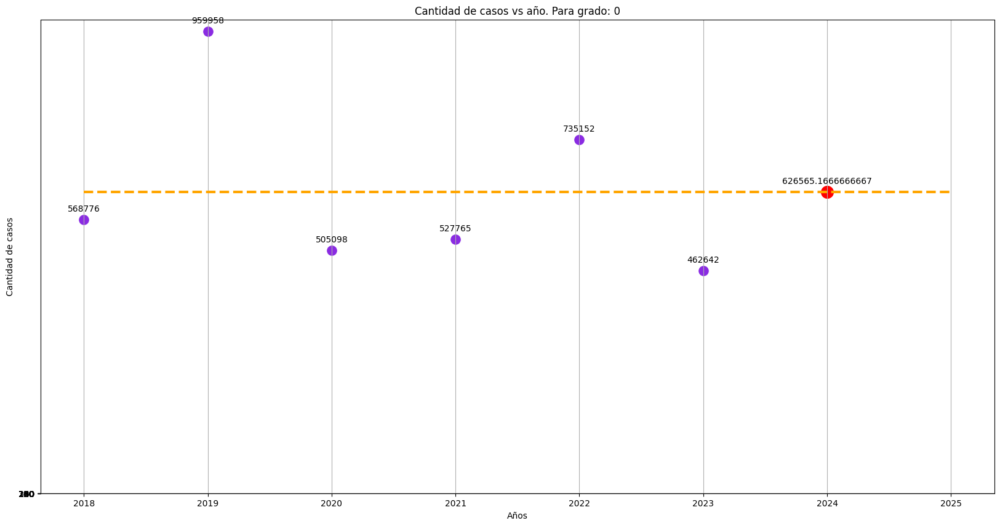

Para grado 1, la predicción para el año 2024 es: 508323.0666666627


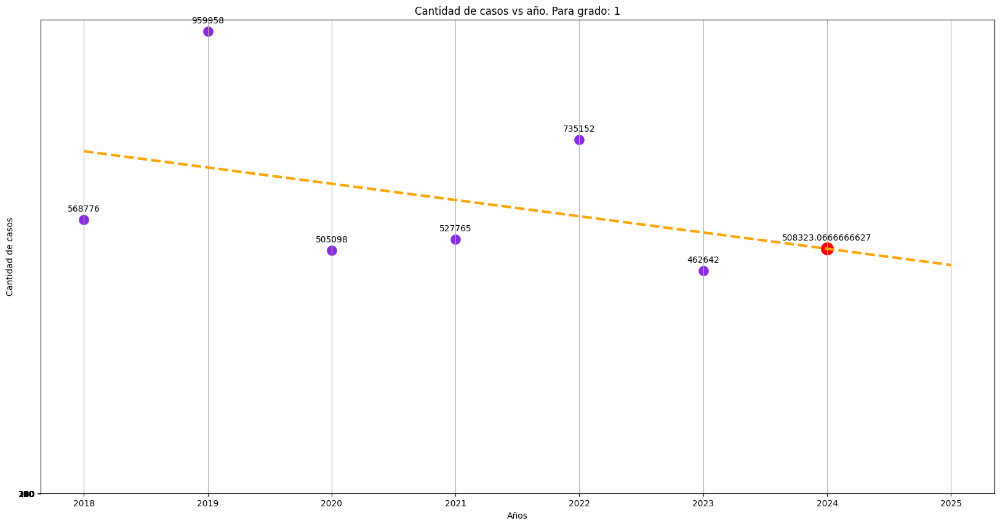

Para grado 2, la predicción para el año 2024 es: 396744.40005493164


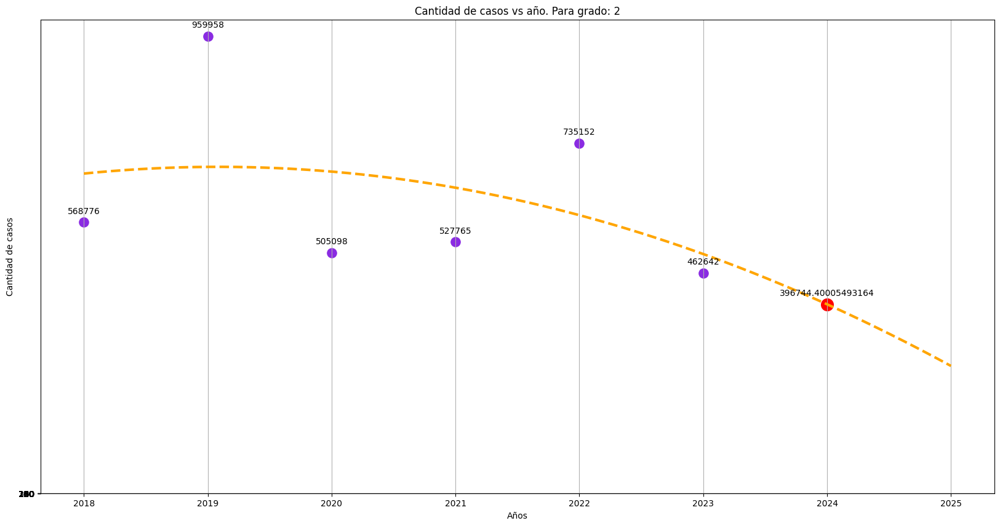

Para grado 3, la predicción para el año 2024 es: 618947.953125


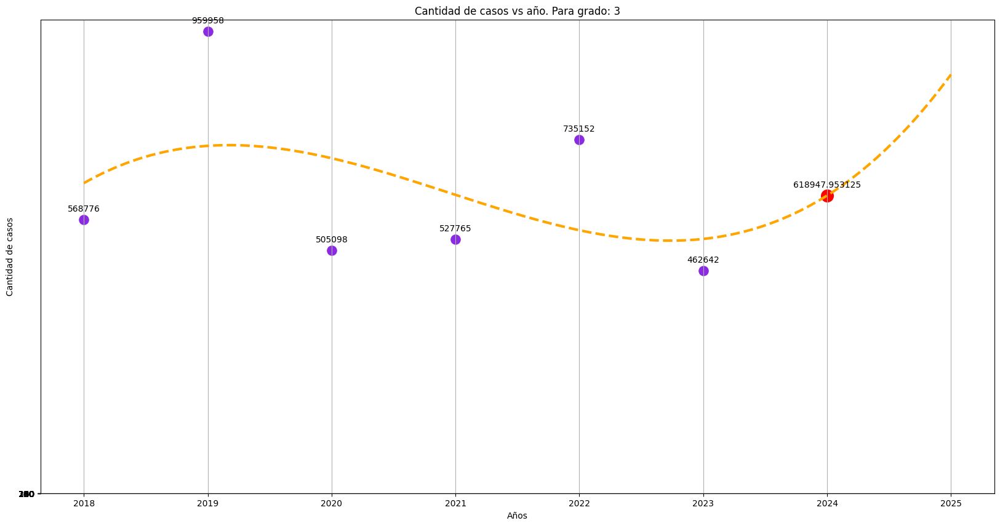

In [ ]:
# Datos de años y cantidades de casos de diarrea
x = np.array([2018, 2019, 2020, 2021, 2022, 2023])
y = np.array([568776, 959958, 505098, 527765, 735152, 462642])

# Función para calcular el polinomio
def polynomial(x, coef):
    return np.polyval(coef, x)

# Año a predecir
anno_prediccion = 2024

for i in range(4): #caculo sobre 4 ya que a mayor grado se desvía mucho, lo cual se puede apreciar en el código de abajo
    # Ajustamos el polinomio
    coef = np.polyfit(x, y, i)

    # Calcular la predicción para el año 2024
    prediccion = polynomial(anno_prediccion, coef)

    print(f"Para grado {i}, la predicción para el año {anno_prediccion} es: {prediccion}")

    # Crear una secuencia de años para la visualización
    x1 = np.linspace(2018, anno_prediccion + 1, 1000)
    y1 = polynomial(x1, coef)

    # Crear el gráfico
    plt.figure(figsize=(20, 10))
    plt.title(f"Cantidad de casos vs año. Para grado: {i}")

    # Agregar tooltips para los puntos
    for xi, yi in zip(x, y):
        plt.scatter(xi, yi, s=120, c='blueviolet')
        plt.annotate(str(yi), (xi, yi), textcoords="offset points", xytext=(0,10), ha='center')

    # Agregar el punto de predicción para 2024
    plt.scatter(anno_prediccion, prediccion, s=200, c='red')
    plt.annotate(f"{prediccion}", (anno_prediccion, prediccion), textcoords="offset points", xytext=(0,10), ha='center')

    plt.plot(x1, y1, "--", linewidth=3, color='orange')
    plt.yticks(range(100, 320, 20))
    plt.grid(True)
    plt.xlabel("Años")
    plt.ylabel("Cantidad de casos")
    plt.show()


Para grado 0 El año es: 29611336592.805553
Para grado 1 El año es: 26282480827.94603
Para grado 2 El año es: 25393209481.253128
Para grado 3 El año es: 24553500453.961872
Para grado 4 El año es: 1029592150.1666666
Para grado 5 El año es: 1024895851.5
Para grado 6 El año es: 1030453398.1666666
Para grado 7 El año es: 1030422982.1666666
Para grado 8 El año es: 1032024403.5
Para grado 9 El año es: 1034482352.8333334
Para grado 10 El año es: 1036568851.5
Para grado 11 El año es: 1038556452.8333334
Para grado 12 El año es: 1040693522.8333334
Para grado 13 El año es: 1042792551.5
Para grado 14 El año es: 1044857559.5
Para grado 15 El año es: 1046819386.1666666
Para grado 16 El año es: 1048903359.5
Para grado 17 El año es: 4821803.5
Para grado 18 El año es: 1128832.8333333333
Para grado 19 El año es: 698112.8333333334
Para grado 20 El año es: 39851.5
Para grado 21 El año es: 43072.833333333336
Para grado 22 El año es: 37291.5
Para grado 23 El año es: 77995.5
Para grado 24 El año es: 54496.833

/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3553: RankWarning: Polyfit may be poo

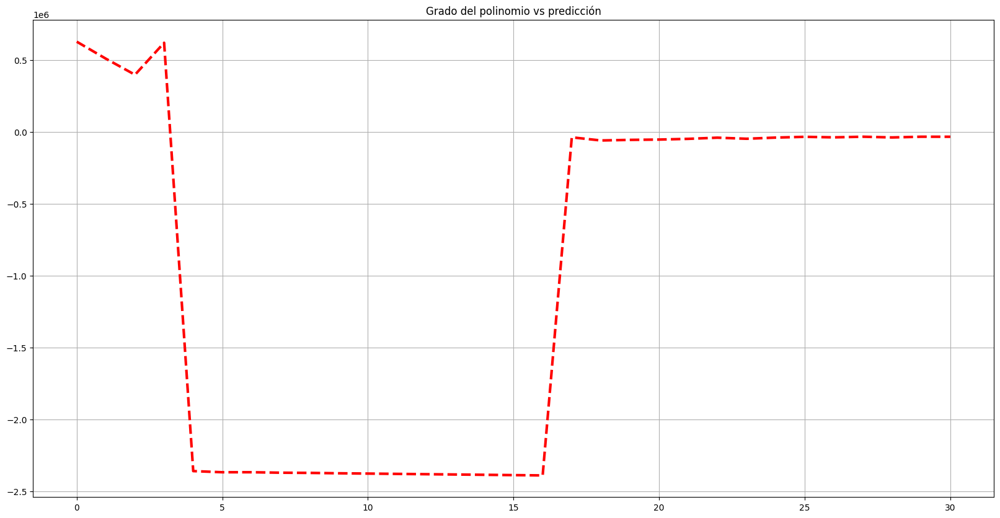

In [ ]:
#Verifico el mejor grado
anno_prediccion = 2024
grado = np.arange(0, 30 + 1, 1) #de 0 a 100 de 1 en 1
aproxi = np.array([])
y_pred_vec = np.array([])
for i in grado:
    coef = np.polyfit(x,y,i)
    p = np.polyval(coef, anno_prediccion)
    aproxi = np.append(aproxi, p)

    # para la MSE
    y_pred_vec = np.array([])
    for j in x: # para la MSE
        y_pred = np.polyval(coef, j)
        y_pred_vec = np.append(y_pred_vec,y_pred)
    #print(f"los y: {y}")
    #print(f"los y_aprox: {y_pred_vec}")
    MSE = (sum( (y - y_pred_vec)**2 ))/len(y)
    print(f"Para grado {i} El año es: {MSE}")
plt.figure(figsize=[20,10])
plt.title("Grado del polinomio vs predicción")
plt.plot(grado,aproxi,"--",linewidth=3,color='red')
plt.grid("on")
plt.show()

In [ ]:
!pip install statsmodels

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/representation.py:374: FutureWarning:

Unknown keyword arguments: dict_keys(['typ']).Passing unknown keyword arguments will raise a TypeError beginning in version 0.15.



Predicción para 2024: 462641.98051199515


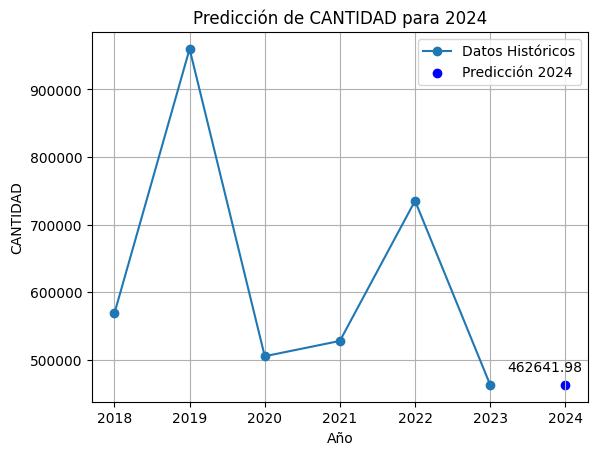

In [ ]:
import statsmodels.api as sm

# Crear un DataFrame con los datos históricos
data = {
    'ANIO': [2018, 2019, 2020, 2021, 2022, 2023],
    'CANTIDAD': [568776, 959958, 505098, 527765, 735152, 462642]
}
df = pd.DataFrame(data)

# Ajustar un modelo ARIMA a los datos
model = sm.tsa.ARIMA(df['CANTIDAD'], order=(1,1,1))
model_fit = model.fit()

# Realizar una predicción para el año 2024
prediction_2024 = model_fit.predict(start=len(df), end=len(df), typ='levels')

print(f'Predicción para 2024: {prediction_2024.iloc[0]}')

# Graficar los datos históricos
plt.plot(df['ANIO'], df['CANTIDAD'], label='Datos Históricos', marker='o', linestyle='-')
# Agregar el punto azul para el año 2024
plt.scatter(2024, prediction_2024.iloc[0], color='blue', marker='o', label='Predicción 2024')
plt.annotate(f'{prediction_2024.iloc[0]:.2f}', (2024, prediction_2024.iloc[0]), textcoords="offset points", xytext=(-15,10), ha='center')
plt.legend()
plt.title('Predicción de CANTIDAD para 2024')
plt.xlabel('Año')
plt.ylabel('CANTIDAD')
plt.grid(True)  # Agregar cuadrícula
plt.show()


